# Pre-Processing of Data

In [1]:
# Misc
import os
import sys
from timeit import default_timer as timer 
import datetime
now = datetime.datetime.now()

# Data manipulation
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
#from netCDF4 import Dataset
import numpy as np
import plotly.graph_objects as go
from scipy.optimize import curve_fit
from scipy.stats import norm
from numpyfy import*
from make_plots import *


# Sanity check for jupyter notebooks
print("Current working directory:", os.getcwd())

Current working directory: c:\Users\gabri\Documents\GitHub\IceClassic\sandbox\content


# Loading the dataframe
The source and explanation of each column is in the txt.

In [2]:
Data=pd.read_csv('Time_series_DATA.txt',skiprows=149,index_col=0)
Data.index=pd.to_datetime(Data.index)
Data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 41351 entries, 1854-01-01 to 2024-02-06
Data columns (total 26 columns):
 #   Column                                             Non-Null Count  Dtype  
---  ------                                             --------------  -----  
 0   Regional: Air temperature [C]                      38563 non-null  float64
 1   Days since start of year                           38563 non-null  float64
 2   Days until break up                                38563 non-null  float64
 3   Predicted ice thickness [m]                        38563 non-null  float64
 4   Noisy predicted ice thickness [m]                  25762 non-null  float64
 5   Nenana: Rainfall [mm]                              29547 non-null  float64
 6   Nenana: Snowfall [mm]                              19945 non-null  float64
 7   Nenana: Snow depth [mm]                            15984 non-null  float64
 8   Nenana: Mean water temperature [C]                 2418 non-null   fl

Dataframe has been -numpified- !!!
 The original datetime index has been converted to three columns,containing year,month and day,in position -3,-2,-1.


c:\Users\gabri\Documents\GitHub\IceClassic\sandbox\content\numpyfy.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Year'] = df.index.year.astype(int)
c:\Users\gabri\Documents\GitHub\IceClassic\sandbox\content\numpyfy.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Month'] =df.index.month.astype(int)
c:\Users\gabri\Documents\GitHub\IceClassic\sandbox\content\numpyfy.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,

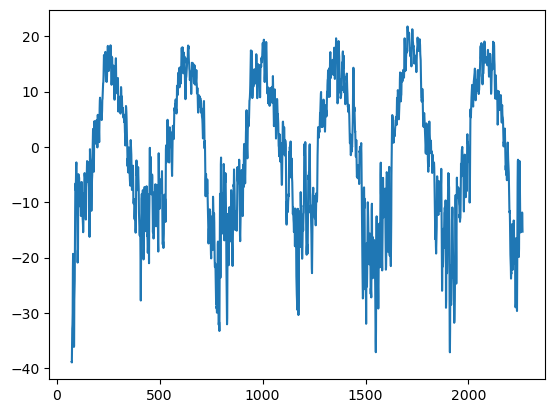

In [3]:
Numpy_DATA=Filter_Numpify(Data,'2000-01-01','2005-12-31',numpyfy=True)
plt.plot(Numpy_DATA[:,-0])


# Visualizing the dataframe


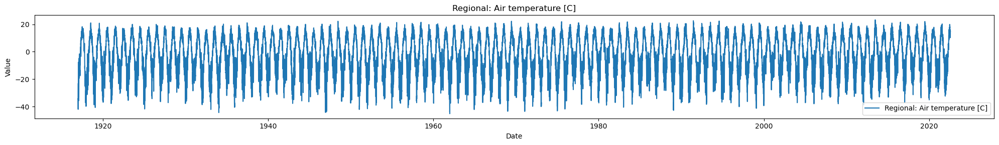

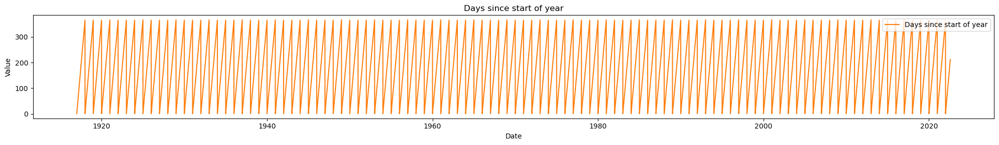

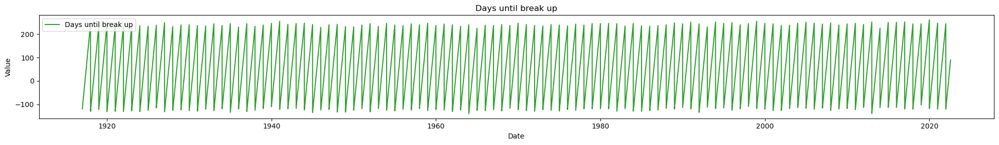

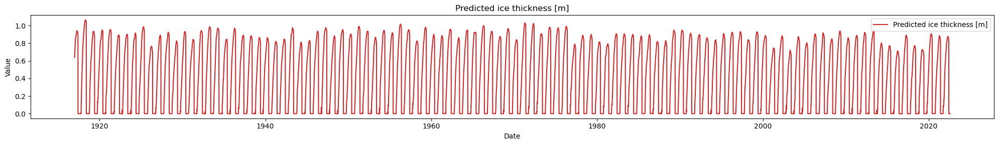

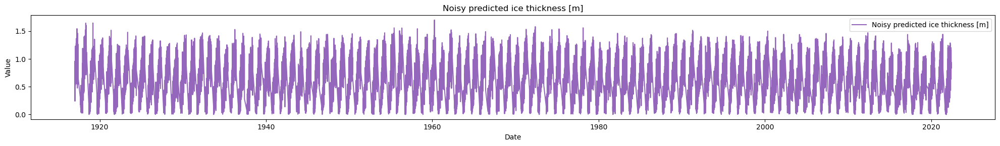

...

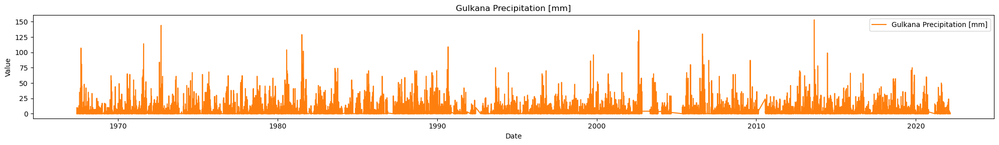

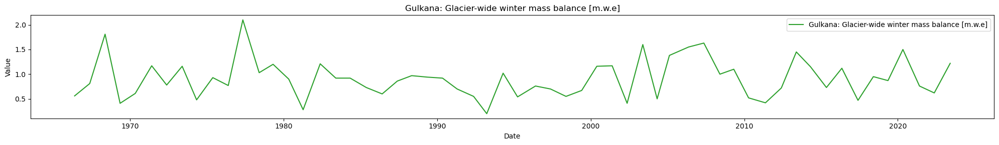

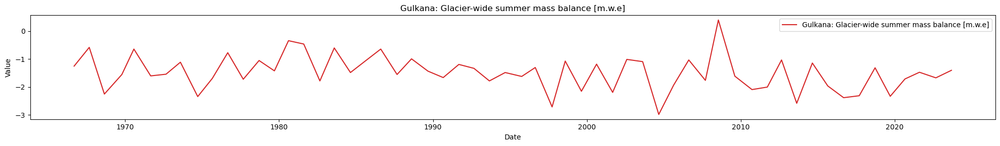

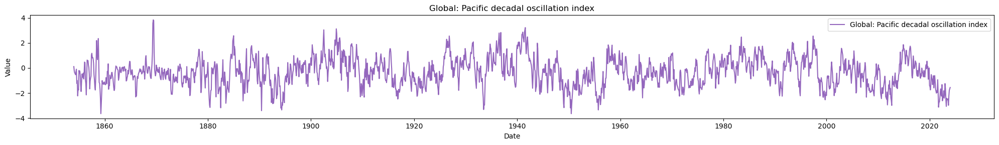

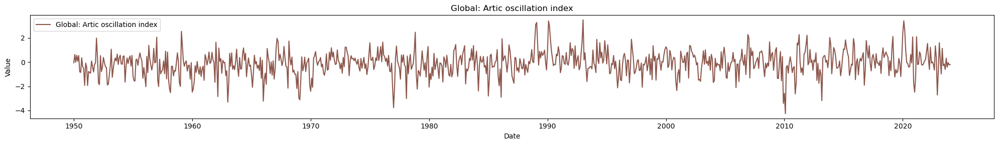

In [4]:
explore_data(Data)

In [5]:
# ploting 'sparse columns' does not work very well ( scatter works jsut fines), so we created sanitized verison simialr as we did in the plots above, also lets drop vert old data

interactive_data(Data)


We have added the **["Days until break up']** and **['Days since start of year']** columns to plot the variables before and after the break up

#

In [ ]:
Data=Data[Data.index.year>2010]

fig, ax1 = plt.subplots(1,1,figsize=(15,5)) 
plt.scatter(Data['Days until break up'],Data['Nenana: Mean Discharge [m3/s]'],color='k',marker='1',alpha=0.8)
plt.xlabel('Days from break up')
plt.title("Nenana: Discharge [m3/s]")
plt.show()



fig, ax1 = plt.subplots(1,1,figsize=(15,5)) 
plt.scatter(Data['Days until break up'],Data['Regional: Air temperature [C]'],color='k',marker='1',alpha=0.8)
plt.xlabel('Days from break up')
plt.title("Nenana: Air temp")
plt.axhline(y=-5,xmin=-100,xmax=100)
plt.axhline(y=0,xmin=-100,xmax=100)
plt.axvline(x=0,ymin=-100,ymax=100)

plt.show()

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 5))
ax.set_title('Air temperature and predicted ice thickness+ synthetic noise')
ax.grid(True)


ax.plot(Data['Nenana: Mean Discharge [m3/s]'], color="aqua", alpha=0.8, label='Nenana: Discharge')
ax.set_ylabel( '[m3/s]')
ax.set_xlim([pd.to_datetime('1965-01-01'),pd.to_datetime('2022-06-01')])
ax.legend()
# Plot vertical lines where the values are 0= break up date
zero_indices = Data.index[Data['Days until break up'] == 0]
for zero_index in zero_indices:
    plt.axvline(x=zero_index, color='r', linestyle='--',alpha=0.2)


# Show plot
plt.show()

In [ ]:
dy_dx = np.gradient((Data['Nenana: Mean Discharge [m3/s]']))
dy2_dx = np.gradient(dy_dx)

fig, ax = plt.subplots(1, 1, figsize=(20, 5))
ax.set_title('Break-up and discharge change')
ax.grid(True)


ax.plot(Data.index,dy_dx, color="deepskyblue", alpha=0.8, label=r'$\partial$'+ 'Discharge')
ax.plot(Data.index,dy2_dx, color="lime", alpha=0.8,label=r'$\partial^2$'+ 'Discharge')
ax.set_ylabel( '[m3/s]')
ax.set_xlim([pd.to_datetime('1965-01-01'),pd.to_datetime('2022-06-01')])
ax.legend()
# Plot vertical lines where the values are 0= break up date
zero_indices = Data.index[Data['Days until break up'] == 0]
for zero_index in zero_indices:
    plt.axvline(x=zero_index, color='r', linestyle='--',alpha=0.2)

plt.ylim([-500,500])
# Show plot
plt.show()

## Glacier Data

In [ ]:
Glaciar_summer=Data['Gulkana: Glacier-wide summer mass balance [m.w.e]'].copy().resample('Y').mean().dropna()
Glaciar_winter=Data['Gulkana: Glacier-wide winter mass balance [m.w.e]'].copy().resample('Y').mean().dropna()
Glaciar_year=Glaciar_winter+Glaciar_summer


fig, ax1 = plt.subplots(1, 1, figsize=(15, 5))
ax1.plot(Glaciar_summer, label='Summer mass change', alpha=0.9, color='r')
ax1.plot(Glaciar_winter, label='Winter mass change', alpha=0.9, color='b')
ax1.plot(Glaciar_year, label='Yearly mass change', alpha=0.9, color='g')
ax1.set_ylabel('Mass change')


ax2 = ax1.twinx()

integral = Glaciar_year.cumsum()
ax2.plot(Glaciar_year.index, integral, label='Accumulated mass change', alpha=0.9, color='magenta',linestyle='--')
ax2.set_ylabel('Accumulated mass change')

# Set title and legend
plt.title('Gulkana Glaciar')
fig. legend(loc='upper left')

plt.show()

In [ ]:
ENSO=Data['Global: ENSO-Southern oscillation index'].copy().resample('Y').mean().dropna()
ENSO.index=pd.to_datetime(ENSO.index)
PDO=Data['Global: Pacific decadal oscillation index'].copy().resample('Y').mean().dropna()
PDO.index=pd.to_datetime(PDO.index)
AO=Data['Global: Artic oscillation index'].copy().resample('Y').mean().dropna()
AO.index=pd.to_datetime(AO.index)
fig, ax1 = plt.subplots(1,1,figsize=(15,5)) 

plt.scatter(Data.index,Data['Global: ENSO-Southern oscillation index'],label='ENSO',alpha=0.2,marker='1',color='r')
plt.scatter(Data.index,Data['Global: Pacific decadal oscillation index'],label=' PDO',alpha=0.2,marker='2',color='b')
plt.scatter(Data.index,Data['Global: Artic oscillation index'],label=' AO',alpha=0.2,marker='3',color='g')

plt.plot(ENSO,label='ENSO-Yearly mean',alpha=0.9,color='r')
plt.plot(PDO,label=' PDO-Yearly mean',alpha=0.9,color='b')
plt.plot(AO,label=' AO-Yearly mean',alpha=0.9,color='g')
plt.title('Global-Long period oscillations')
plt.xlim([pd.to_datetime('1950-01-01'),pd.to_datetime('2024-01-01')])
plt.legend(loc='upper left')
plt.show()